# Model Postamat


In [660]:
# imports
import pandas as pd
import numpy as np
import re
import geopandas

import seaborn as sns
from matplotlib import pyplot as plt
%matplotlib inline

# settings
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 50)

In [661]:
from sklearn.pipeline import make_pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import roc_auc_score
from sklearn.preprocessing import StandardScaler



## Load data

In [662]:
PATH_DATASET = "datasets/"
PATH_DATASET_RESULT = PATH_DATASET + "result/"

In [663]:
# Load dataset
train_filename = PATH_DATASET_RESULT + "dataset_for_model.csv"
test_filename = PATH_DATASET_RESULT + "df_object_hexagon_9.csv"

train_df = pd.read_csv(train_filename, sep=";").iloc[:,2:]
test_df = pd.read_csv(test_filename, sep=";").iloc[:,2:]
train_df.shape, test_df.shape

((24932, 57), (64455, 56))

In [664]:
test_df.columns

Index(['type', 'name', 'geometry_name', 'lon', 'lat', 'geometry', 'K_distance',
       'distance_to_center', 'normalize_name', 'okato', 'prc_children_1_6',
       'region_average_age', 'count_nearest_postamats', 'count_nearest_pvz',
       'count_nearest_pvz_shop', 'food_delivery', 'velo_parking',
       'digitalization', 'digitalization_without_postamat',
       'covering_postamats', 'count_nearest_metro', 'count_nearest_ngpt',
       'count_nearest_auto_parking', 'transportization',
       'level_working_region', 'level_sleeping_region', 'count_house_flat',
       'population_house_flat', 'population_house_square',
       'population_house_living_square', 'count_nearest_postamats_x2',
       'count_nearest_postamats_x3', 'level_sleep_work_region',
       'region_population', 'average_salary', 'average_employees',
       'prc_employees_small_businesses', 'count_small_enterprises',
       'investments', 'price_metr_housing', 'cost_apartment', 'rating_ecology',
       'entertainment_inf

In [665]:
drop_columns = ["type", "name","geometry_name", "lon", "lat", "okato", "normalize_name", "covering_postamats", 'count_nearest_postamats', 'count_nearest_postamats_x2', "count_nearest_postamats_x3", "digitalization", "turnover_postamats", "geometry", "target"]
num_cols = list(train_df.columns)
num_cols = list(set(num_cols) - set(drop_columns))
target_col = ["target"]

train_df[num_cols]

,count_nearest_pvz_shop,population_region,budget_revenues,prc_employees_small_businesses,death_rate,prc_children_1_6,count_nearest_metro,house_infrastructure_rating,prc_xenophobic,population_house_square,level_sleeping_region,distance_to_center,cost_apartment,area_per_human_region,count_nearest_ngpt,natural_population_growth,rating_ecology,migration_population_growth,investments,price_metr_housing,prc_people_higher_education,level_sleep_work_region,digitalization_without_postamat,transportization,average_salary,region_average_age,population_house_flat,average_employees,total_fertility_rate,count_nearest_auto_parking,entertainment_infrastructure,prc_children_5_18,K_distance,velo_parking,budget_expenditures,level_working_region,count_house_flat,count_small_enterprises,count_nearest_pvz,region_population,food_delivery,population_density_region,population_house_living_square
0,11,93400,23881,39.62,9.7,6.69,1,36,11.48,911,21085,5.590130,41185,17.4,3,-3.3,7,7.7,578763,205429,48.47,0.287324,0.394972,0.059987,99175,41.7,758,58801,6.4,2,85,12.10,0.1949,2,22817,73384,237,917,6,93400,0,7414,616
1,11,93400,23881,39.62,9.7,6.69,1,36,11.48,911,21085,5.590130,41185,17.4,3,-3.3,7,7.7,578763,205429,48.47,0.287324,0.394972,0.059987,99175,41.7,758,58801,6.4,2,85,12.10,0.1949,2,22817,73384,237,917,6,93400,0,7414,616
2,11,93400,23881,39.62,9.7,6.69,1,36,11.48,911,21085,5.590130,41185,17.4,3,-3.3,7,7.7,578763,205429,48.47,0.287324,0.394972,0.059987,99175,41.7,758,58801,6.4,2,85,12.10,0.1949,2,22817,73384,237,917,6,93400,0,7414,616
3,8,93400,23881,39.62,9.7,6.69,1,36,11.48,3651,21085,5.671999,41185,17.4,5,-3.3,7,7.7,578763,205429,48.47,0.287324,0.368280,0.061684,99175,41.7,2916,58801,6.4,0,85,12.10,0.1949,1,22817,73384,911,917,6,93400,0,7414,2694
4,10,93400,23881,39.62,9.7,6.69,1,36,11.48,3141,21085,5.595810,41185,17.4,5,-3.3,7,7.7,578763,205429,48.47,0.287324,0.394138,0.073954,99175,41.7,2635,58801,6.4,4,85,12.10,0.1949,2,22817,73384,823,917,5,93400,1,7414,2405
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24927,1,8600,48422,47.62,9.6,3.86,0,14,25.89,9730,7261,27.443196,15556,11.1,1,2.9,30,38.4,159992,98557,33.05,2.313894,0.103333,0.003916,156344,41.6,7712,568,12.5,0,0,5.83,0.1949,0,25603,3138,2410,180,1,8600,0,455,7348
24928,0,8600,48422,47.62,9.6,3.86,0,14,25.89,10871,4579,27.478005,15556,11.1,1,2.9,30,38.4,159992,98557,33.05,2.415084,0.098186,0.003916,156344,41.6,7267,568,12.5,0,0,5.83,0.1949,0,25603,1896,2271,180,1,8600,0,455,8217
24929,0,8600,48422,47.62,9.6,3.86,0,14,25.89,8039,4595,27.449695,15556,11.1,0,2.9,30,38.4,159992,98557,33.05,2.414609,0.082500,0.000000,156344,41.6,5232,568,12.5,0,0,5.83,0.1949,0,25603,1903,1635,180,0,8600,0,455,6072
24930,0,8600,48422,47.62,9.6,3.86,0,14,25.89,3853,4615,27.401291,15556,11.1,0,2.9,30,38.4,159992,98557,33.05,2.414966,0.082500,0.000000,156344,41.6,2956,568,12.5,0,0,5.83,0.1949,0,25603,1911,924,180,0,8600,0,455,2897


In [666]:

# train_df = train_df.drop(columns=drop_columns)
# num_cols = list(test_df.drop(columns=drop_columns).columns)
# test_df = test_df[num_cols]

# num_cols = ['distance_to_center',
# #        'count_nearest_postamats', 
# #         'count_nearest_postamats_2km',
#        'count_nearest_pvz', 'food_delivery', 'digitalization',
#        'covering_postamats', 'count_nearest_metro',
#        'count_nearest_ngpt', 'level_working_region', 'level_sleeping_region',
# #        'count_house_flat', 'population_house_flat', 'population_house_square',
# #        'population_house_living_square', 
#             'count_house_flat_400',
#        'population_house_flat_400', 'population_house_square_400',
#        'population_house_living_square_400', 
# #             'count_house_flat_200',
# #        'population_house_flat_200', 'population_house_square_200',
# #        'population_house_living_square_200'
#            ]
# cat_cols = []
# bin_cols = [] # 0/1

train_df.isna().sum()


type                                   0
name                                   0
geometry_name                         14
lon                                    0
lat                                    0
geometry                           18714
K_distance                             0
distance_to_center                     0
normalize_name                         0
okato                                  0
prc_children_1_6                       0
region_average_age                     0
count_nearest_postamats                0
count_nearest_pvz                      0
count_nearest_pvz_shop                 0
food_delivery                          0
velo_parking                           0
digitalization                         0
digitalization_without_postamat        0
covering_postamats                     0
count_nearest_metro                    0
count_nearest_ngpt                     0
count_nearest_auto_parking             0
transportization                       0
level_working_re

## Preprocessing dataset

# Data analysis
## Correlation matrix

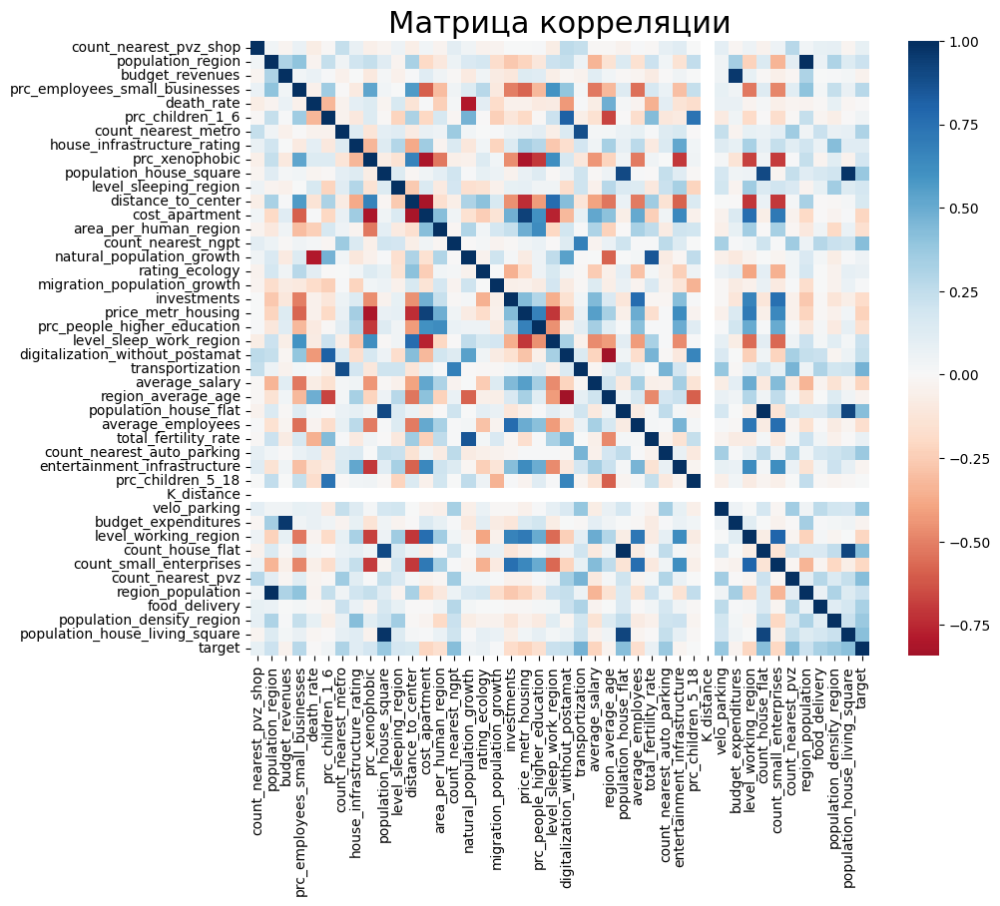

In [667]:
correlation = train_df[num_cols + target_col].corr()

plt.figure(figsize=(10, 8))
sns.heatmap(
    correlation,
    xticklabels=correlation.columns,
    yticklabels=correlation.columns,
    cmap="RdBu",
    center=0,
)

plt.title("Матрица корреляции", fontsize=22)
plt.show()

# Create models

## Normalization + split train/test

In [668]:
y_data = train_df[target_col]
clear_y_data = y_data.values[:,0]
x_data = train_df[num_cols + cat_cols + bin_cols].copy().sort_index()
x_data_test = test_df[num_cols + cat_cols + bin_cols].copy().sort_index()
y_data_ohe = np.array([[1-targ, targ] for targ in clear_y_data])
x_data.shape, x_data_test.shape, y_data_ohe.shape

((24932, 43), (64455, 43), (24932, 2))

In [669]:
# Разбиваем данные на train, test, val
from sklearn.model_selection import train_test_split


x_train, x_val, y_train, y_val, clear_y_train, clear_y_val = train_test_split(x_data, y_data_ohe, clear_y_data, train_size = 0.8,  shuffle=True)

x_train.shape, x_val.shape, y_train.shape, y_val.shape


((19945, 43), (4987, 43), (19945, 2), (4987, 2))

In [670]:
train_df[target_col].value_counts()

target
0         13950
1         10982
dtype: int64

In [671]:
# x_train.columns
# num_cols

In [672]:
scaler = StandardScaler()
scaler.fit(x_train)


x_train_normalize = scaler.transform(x_train)
x_val_normalize = scaler.transform(x_val)
x_test_normalize= scaler.transform(x_data_test)

x_train_normalize.shape, x_val_normalize.shape, x_test_normalize.shape

((19945, 43), (4987, 43), (64455, 43))

## Create and fit Tensorflow model

In [673]:
import tensorflow
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, BatchNormalization, Dropout


Epoch 1/20
100/100 [==============================] - 5s 27ms/step - loss: 0.2839 - accuracy: 0.8798 - auc: 0.9511 - precision: 0.8798 - recall: 0.8798 - val_loss: 0.3001 - val_accuracy: 0.9044 - val_auc: 0.9685 - val_precision: 0.9044 - val_recall: 0.9044
Epoch 2/20
100/100 [==============================] - 2s 21ms/step - loss: 0.2076 - accuracy: 0.9141 - auc: 0.9708 - precision: 0.9141 - recall: 0.9141 - val_loss: 0.2204 - val_accuracy: 0.9188 - val_auc: 0.9785 - val_precision: 0.9188 - val_recall: 0.9188
Epoch 3/20
100/100 [==============================] - 2s 21ms/step - loss: 0.1825 - accuracy: 0.9260 - auc: 0.9765 - precision: 0.9260 - recall: 0.9260 - val_loss: 0.1844 - val_accuracy: 0.9286 - val_auc: 0.9769 - val_precision: 0.9286 - val_recall: 0.9286
Epoch 4/20
100/100 [==============================] - 2s 21ms/step - loss: 0.1693 - accuracy: 0.9315 - auc: 0.9789 - precision: 0.9315 - recall: 0.9315 - val_loss: 0.1546 - val_accuracy: 0.9356 - val_auc: 0.9828 - val_precision: 

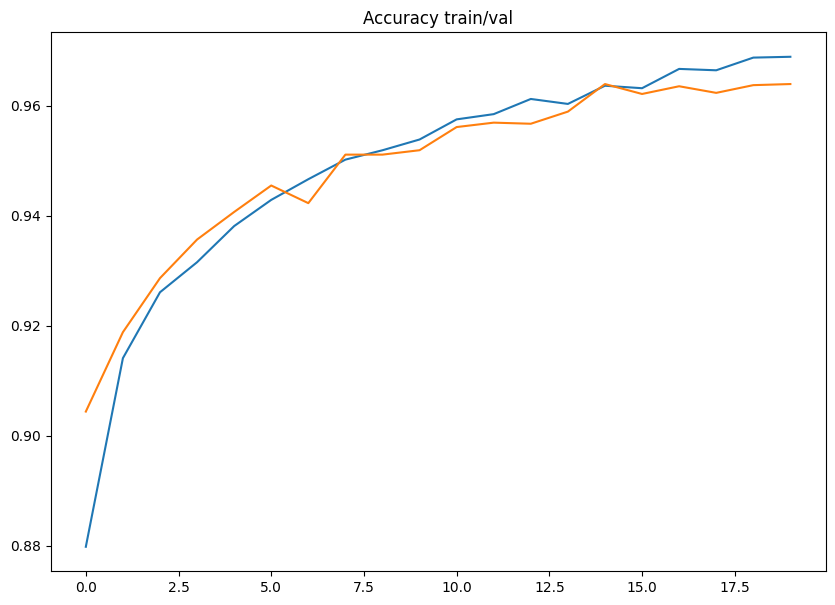

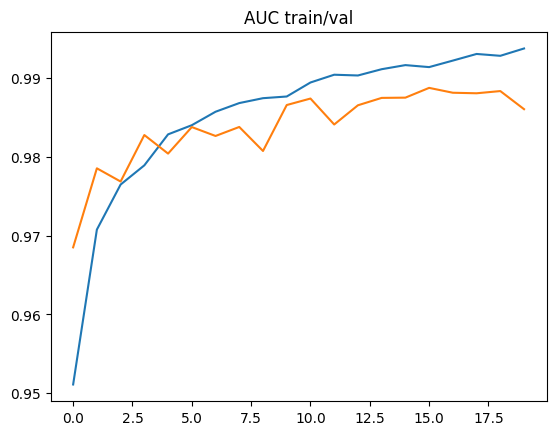

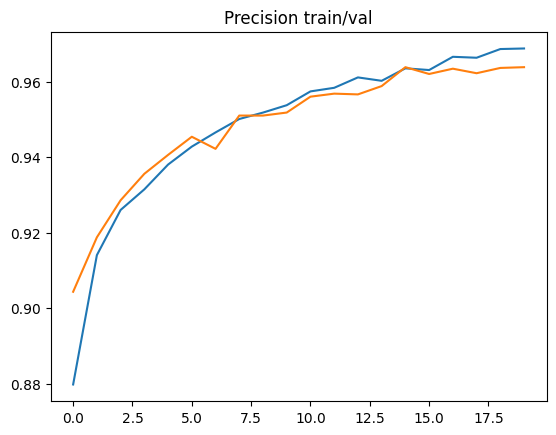

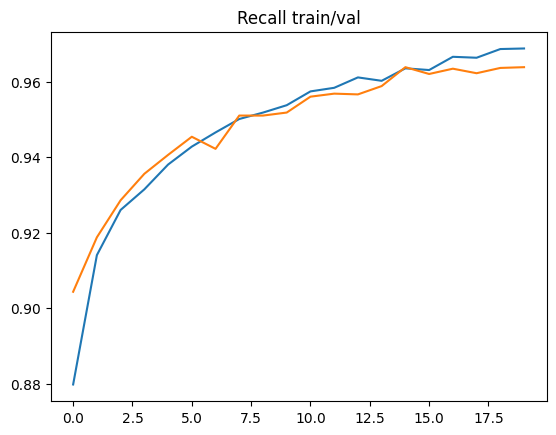

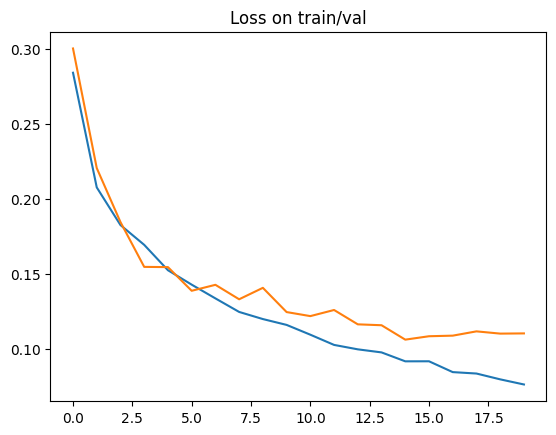

In [674]:
model = Sequential()
model.add(Dense(800, input_shape=(x_train_normalize.shape[1:]), activation="relu"))
model.add(Dropout(0.2))
model.add(BatchNormalization())
model.add(Dense(400, activation="relu")) 
model.add(Dropout(0.2))
model.add(BatchNormalization())
model.add(Dense(200, activation="relu"))
model.add(Dropout(0.1))
model.add(BatchNormalization())
model.add(Dense(50, activation="relu"))
model.add(Dropout(0.1))
model.add(Dense(2, activation="softmax"))
model.compile( optimizer="Nadam", loss="binary_crossentropy", metrics=["accuracy", "AUC", "Precision", "Recall"] ) 

history = model.fit( x_train_normalize, y_train, epochs=20, validation_data=(x_val_normalize, y_val), verbose=True, batch_size=200)

plt.figure(figsize=(10,7))

plt.plot(history.history["accuracy"], label="accuracy")
plt.plot(history.history["val_accuracy"], label="val_accuracy")
plt.title("Accuracy train/val")
plt.show()

plt.plot(history.history["auc"], label="auc")
plt.plot(history.history["val_auc"], label="val_auc")
plt.title("AUC train/val")
plt.show()


plt.plot(history.history["precision"], label="precision")
plt.plot(history.history["val_precision"], label="val_precision")
plt.title("Precision train/val")
plt.show()

plt.plot(history.history["recall"], label="recall")
plt.plot(history.history["val_recall"], label="val_recall")
plt.title("Recall train/val")
plt.show()



plt.plot(history.history["loss"], label="loss")
plt.plot(history.history["val_loss"], label="val_loss")
plt.title("Loss on train/val")
plt.show()

## Fit models sklearn
Create and fit models sklearn:

    - AdaBoostClassifier
    - GradientBoostingClassifier
    - DecisionTreeClassifier
    - RandomForestClassifier
    - ExtraTreesClassifier
    - HistGradientBoostingClassifier
    - LogisticRegression

In [675]:
from sklearn.ensemble import AdaBoostClassifier

ada_model = AdaBoostClassifier()
ada_model.fit(x_train_normalize, clear_y_train)

ada_predict_val = ada_model.predict(x_val_normalize)
roc_auc_score(clear_y_val, ada_predict_val)


0.8848697581714107

In [676]:
from sklearn.ensemble import GradientBoostingClassifier

gradient_model = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0, max_depth=1, random_state=0)
gradient_model.fit(x_train_normalize, clear_y_train)

gradient_predict_val = gradient_model.predict(x_val_normalize)
roc_auc_score(clear_y_val, gradient_predict_val)

0.899913761221678

In [677]:
from sklearn.tree import DecisionTreeClassifier

decis_model = DecisionTreeClassifier(max_depth=None, min_samples_split=2, random_state=0)
decis_model.fit(x_train_normalize, clear_y_train)
decis_predict_val = decis_model.predict(x_val_normalize)
roc_auc_score(clear_y_val, decis_predict_val)

0.9456774244224293

In [815]:
from sklearn.ensemble import RandomForestClassifier

forest_model = RandomForestClassifier(n_estimators=10, max_depth=None, min_samples_split=2, random_state=0)
forest_model.fit(x_train_normalize, clear_y_train)
forest_predict_val = forest_model.predict(x_val_normalize)
roc_auc_score(clear_y_val, forest_predict_val)

0.9675488550043039

In [816]:
from sklearn.calibration import CalibratedClassifierCV
forest_model_for_calibr = RandomForestClassifier(n_estimators=10, max_depth=None, min_samples_split=2, random_state=0)

calibrated_forest_model = CalibratedClassifierCV(forest_model_for_calibr, cv=10)
calibrated_forest_model.fit(x_train_normalize, clear_y_train)

calibrated_forest_predict_val = calibrated_forest_model.predict(x_val_normalize)
roc_auc_score(clear_y_val, calibrated_forest_predict_val)

0.9738855233401079

In [679]:
from sklearn.ensemble import ExtraTreesClassifier

extra_model = ExtraTreesClassifier(n_estimators=10, max_depth=None, min_samples_split=2, random_state=0)
extra_model.fit(x_train_normalize, clear_y_train)
extra_predict_val = extra_model.predict(x_val_normalize)
roc_auc_score(clear_y_val, extra_predict_val)

0.9762245251957964

In [680]:
from sklearn.ensemble import HistGradientBoostingClassifier

hist_gradient_model = HistGradientBoostingClassifier(max_iter=100)
hist_gradient_model.fit(x_train_normalize, clear_y_train)
hist_gradient_predict_val = hist_gradient_model.predict(x_val_normalize)
roc_auc_score(clear_y_val, hist_gradient_predict_val)

0.9608840865726058

In [681]:
from sklearn.linear_model import LogisticRegression

logler_model = LogisticRegression(solver='liblinear', C=4, penalty='l1')
logler_model.fit(x_train_normalize, clear_y_train)
logler_predict_val = logler_model.predict(x_val_normalize)
roc_auc_score(clear_y_val, logler_predict_val)

0.8458975214942382

### Feature importances 

In [682]:
feature_importances = pd.Series(forest_model.feature_importances_, index=num_cols)
forest_model.feature_importances_

array([0.01426095, 0.00887955, 0.0081306 , 0.0144478 , 0.00969305,
       0.0096    , 0.00928161, 0.00829919, 0.01611838, 0.08258547,
       0.02174916, 0.03507611, 0.01087356, 0.0236546 , 0.03268672,
       0.01014797, 0.00800961, 0.00973059, 0.02061569, 0.00770875,
       0.01245863, 0.0238554 , 0.0300681 , 0.06869146, 0.0160136 ,
       0.00589438, 0.0876518 , 0.01771968, 0.00876725, 0.03392166,
       0.00965515, 0.00657423, 0.        , 0.04874267, 0.00498406,
       0.02920616, 0.05619133, 0.01224257, 0.03335057, 0.00890807,
       0.00916453, 0.01648921, 0.09790016])

In [683]:
feature_importances.nlargest(x_data_test.shape[0])*5

population_house_living_square     0.489501
population_house_flat              0.438259
population_house_square            0.412927
transportization                   0.343457
count_house_flat                   0.280957
velo_parking                       0.243713
distance_to_center                 0.175381
count_nearest_auto_parking         0.169608
count_nearest_pvz                  0.166753
count_nearest_ngpt                 0.163434
digitalization_without_postamat    0.150340
level_working_region               0.146031
level_sleep_work_region            0.119277
area_per_human_region              0.118273
level_sleeping_region              0.108746
investments                        0.103078
average_employees                  0.088598
population_density_region          0.082446
prc_xenophobic                     0.080592
average_salary                     0.080068
prc_employees_small_businesses     0.072239
count_nearest_pvz_shop             0.071305
prc_people_higher_education     

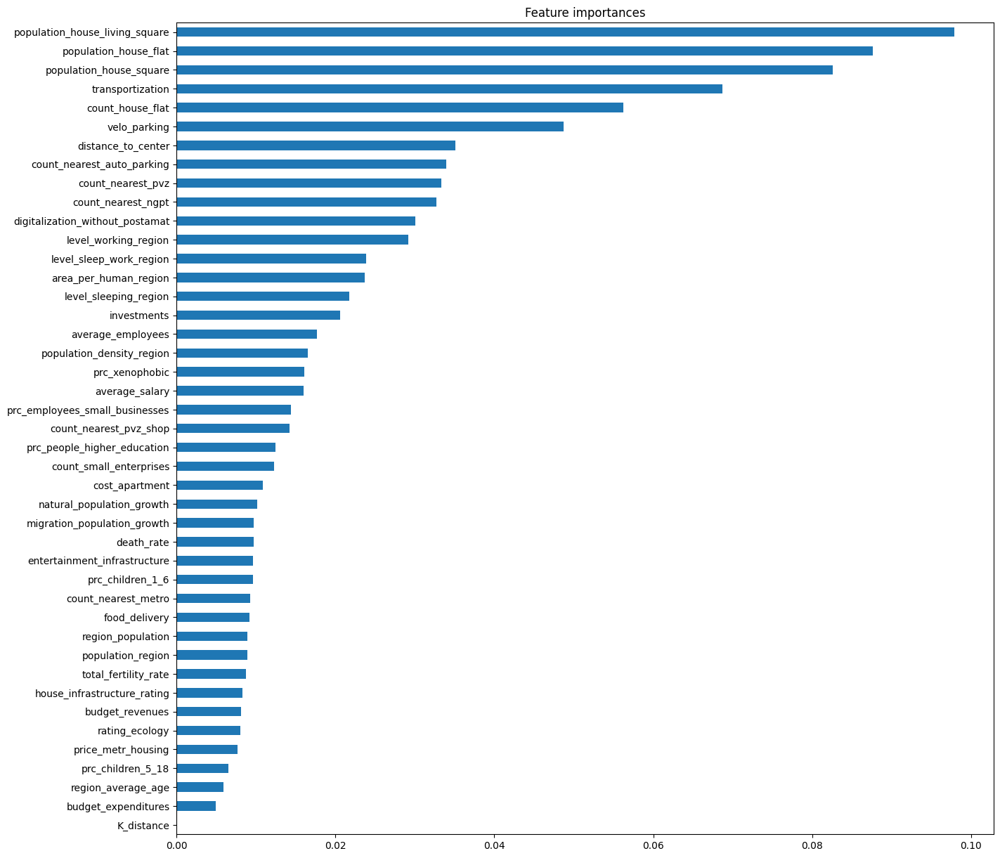

64455

In [684]:
feature_importances.nsmallest(x_data_test.shape[0]).plot(kind='barh', title="Feature importances", figsize=(15,15))
plt.show()

Text(0.5, 0, 'False Positive Rate')

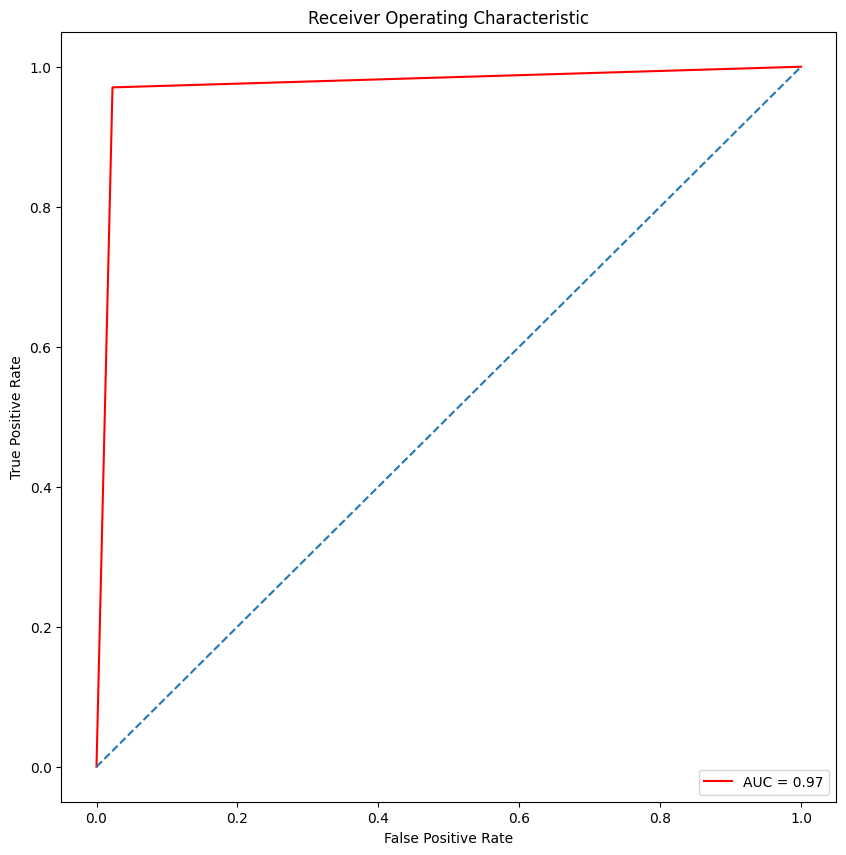

In [825]:
from sklearn.metrics import roc_curve, auc
false_positive_rate, true_positive_rate, thresholds = roc_curve(clear_y_val, calibrated_forest_predict_val)
roc_auc = auc(false_positive_rate, true_positive_rate)

plt.figure(figsize=(10,10))
plt.title('Receiver Operating Characteristic')
plt.plot(false_positive_rate,true_positive_rate, color='red',label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],linestyle='--')
plt.axis('tight')
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')

In [ ]:
from sklearn.ensemble import RandomForestClassifier

forest_model = RandomForestClassifier(n_estimators=10, max_depth=None, min_samples_split=2, random_state=0)
forest_model.fit(x_train_normalize, clear_y_train)
forest_predict_val = forest_model.predict(x_val_normalize)
roc_auc_score(clear_y_val, forest_predict_val)

## Create mean predict from 7 models sklearn + model tensorflow

In [685]:
from sklearn.ensemble import VotingClassifier
voting_model = VotingClassifier(
    estimators=[
                ('ada_model', ada_model), 
                ('gradient_model', gradient_model), 
                ('decis_model', decis_model), 
                ('forest_model', forest_model), 
                ('extra_model', extra_model), 
                ('logler_model', logler_model),                 
                ('hist_gradient_model', hist_gradient_model), 
               ],    voting='hard')

voting_model.fit(x_train_normalize, clear_y_train)
voting_predict_val = voting_model.predict(x_val_normalize)
roc_auc_score(clear_y_val, voting_predict_val)

0.9581493190900254

In [686]:
test_for_model = x_data_test[num_cols]
test_for_model


,count_nearest_pvz_shop,population_region,budget_revenues,prc_employees_small_businesses,death_rate,prc_children_1_6,count_nearest_metro,house_infrastructure_rating,prc_xenophobic,population_house_square,level_sleeping_region,distance_to_center,cost_apartment,area_per_human_region,count_nearest_ngpt,natural_population_growth,rating_ecology,migration_population_growth,investments,price_metr_housing,prc_people_higher_education,level_sleep_work_region,digitalization_without_postamat,transportization,average_salary,region_average_age,population_house_flat,average_employees,total_fertility_rate,count_nearest_auto_parking,entertainment_infrastructure,prc_children_5_18,K_distance,velo_parking,budget_expenditures,level_working_region,count_house_flat,count_small_enterprises,count_nearest_pvz,region_population,food_delivery,population_density_region,population_house_living_square
0,0,93400,23881,39.62,9.7,6.69,1,36,11.48,0,19543,6.295702,41185,17.4,1,-3.3,7,7.7,578763,205429,48.47,0.243236,0.221736,0.049088,99175,41.7,0,58801,6.4,1,85,12.10,0.1949,0,22817,80346,0,917,0,93400,0,7414,0
1,3,93400,23881,39.62,9.7,6.69,0,36,11.48,80,42671,3.362210,41185,17.4,0,-3.3,7,7.7,578763,205429,48.47,0.205965,0.252864,0.003067,99175,41.7,99,58801,6.4,1,85,12.10,0.1949,0,22817,207176,31,917,1,93400,0,7414,65
2,11,93400,23881,39.62,9.7,6.69,1,36,11.48,911,21085,5.590130,41185,17.4,3,-3.3,7,7.7,578763,205429,48.47,0.287324,0.394972,0.059987,99175,41.7,758,58801,6.4,2,85,12.10,0.1949,2,22817,73384,237,917,6,93400,0,7414,616
3,1,93400,23881,39.62,9.7,6.69,1,36,11.48,3994,9168,4.900827,41185,17.4,8,-3.3,7,7.7,578763,205429,48.47,0.171682,0.325315,0.104105,99175,41.7,4156,58801,6.4,10,85,12.10,0.1949,0,22817,53401,1299,917,5,93400,1,7414,3148
4,4,93400,23881,39.62,9.7,6.69,0,36,11.48,3975,34053,4.847021,41185,17.4,4,-3.3,7,7.7,578763,205429,48.47,0.327726,0.278011,0.021798,99175,41.7,4156,58801,6.4,2,85,12.10,0.1949,0,22817,103907,1298,917,1,93400,1,7414,3330
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64450,0,8600,48422,47.62,9.6,3.86,0,14,25.89,8039,4595,27.449695,15556,11.1,0,2.9,30,38.4,159992,98557,33.05,2.414609,0.082500,0.000000,156344,41.6,5232,568,12.5,0,0,5.83,0.1949,0,25603,1903,1635,180,0,8600,0,455,6072
64451,0,8600,48422,47.62,9.6,3.86,0,14,25.89,3853,4615,27.401291,15556,11.1,0,2.9,30,38.4,159992,98557,33.05,2.414966,0.082500,0.000000,156344,41.6,2956,568,12.5,0,0,5.83,0.1949,0,25603,1911,924,180,0,8600,0,455,2897
64452,0,8600,48422,47.62,9.6,3.86,0,14,25.89,3853,4654,27.305704,15556,11.1,0,2.9,30,38.4,159992,98557,33.05,2.415153,0.082500,0.000000,156344,41.6,2956,568,12.5,0,0,5.83,0.1949,0,25603,1927,924,180,0,8600,0,455,2897
64453,0,8600,48422,47.62,9.6,3.86,0,14,25.89,3987,4695,27.175021,15556,11.1,0,2.9,30,38.4,159992,98557,33.05,2.413882,0.082500,0.000000,156344,41.6,3353,568,12.5,0,0,5.83,0.1949,0,25603,1945,1048,180,0,8600,0,455,2968


In [817]:
test_for_model = x_data_test[num_cols]

tf_predict = model.predict(x_test_normalize)[:,1]
gradient_predict = gradient_model.predict_proba(x_test_normalize)[:,1]
decis_predict = decis_model.predict_proba(x_test_normalize)[:,1]
forest_predict = forest_model.predict_proba(x_test_normalize)[:,1]
calibrated_forest_predict = calibrated_forest_model.predict_proba(x_test_normalize)[:,1]
extra_predict = extra_model.predict_proba(x_test_normalize)[:,1]
logler_predict = logler_model.predict_proba(x_test_normalize)[:,1]
hist_gradient_predict = hist_gradient_model.predict_proba(x_test_normalize)[:,1]

In [818]:
test_df["tf_predict"] = tf_predict
test_df["gradient_predict"] = gradient_predict
test_df["decis_predict"] = decis_predict
test_df["forest_predict"] = forest_predict
test_df["calibrated_forest_predict"] = calibrated_forest_predict
test_df["extra_predict"] = extra_predict
test_df["logler_predict"] = logler_predict
test_df["hist_gradient_predict"] = hist_gradient_predict
test_df["ensemble_predict"] = test_df[["tf_predict", "gradient_predict", "forest_predict", "extra_predict", "logler_predict", "hist_gradient_predict"]].mean(axis=1)
test_df

,type,name,geometry_name,lon,lat,geometry,K_distance,distance_to_center,normalize_name,okato,prc_children_1_6,region_average_age,count_nearest_postamats,count_nearest_pvz,count_nearest_pvz_shop,food_delivery,velo_parking,digitalization,digitalization_without_postamat,covering_postamats,count_nearest_metro,count_nearest_ngpt,count_nearest_auto_parking,transportization,level_working_region,...,cost_apartment,rating_ecology,entertainment_infrastructure,house_infrastructure_rating,prc_xenophobic,area_per_human_region,population_density_region,population_region,prc_people_higher_education,death_rate,total_fertility_rate,prc_children_5_18,migration_population_growth,natural_population_growth,budget_expenditures,budget_revenues,tf_predict,gradient_predict,decis_predict,forest_predict,extra_predict,logler_predict,hist_gradient_predict,ensemble_predict,calibrated_forest_predict
0,Постамат,"Леруа Мерлен, постамат","проспект Лихачёва, 15",37.646076,55.699468,NaN,0.1949,6.295702,даниловский,45296559000,6.69,41.7,2,0,0,0,0,0.237388,0.221736,2,1,1,1,0.049088,80346,...,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.10,7.7,-3.3,22817,23881,2.276985e-04,0.011657,0.0,0.0,0.0,0.101390,0.029320,0.023766,0.007195
1,Постамат,"OZON box, автоматизированный пункт выдачи","1-й Кожевнический переулок, 4",37.646195,55.727633,NaN,0.1949,3.362210,даниловский,45296559000,6.69,41.7,2,1,3,0,0,0.268516,0.252864,3,0,0,1,0.003067,207176,...,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.10,7.7,-3.3,22817,23881,4.284233e-10,0.001072,0.0,0.2,0.0,0.003379,0.012694,0.036191,0.011852
2,Постамат,"OZON box, Постамат №3406","Ленинская Слобода, 19 ст2",37.655232,55.707906,NaN,0.1949,5.590130,даниловский,45296559000,6.69,41.7,12,6,11,0,2,0.488885,0.394972,18,1,3,2,0.059987,73384,...,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.10,7.7,-3.3,22817,23881,1.000000e+00,0.929142,1.0,1.0,1.0,0.914843,0.991282,0.972544,0.992927
3,Постамат,"Cainiao, постамат","Большая Тульская, 2",37.620965,55.710139,NaN,0.1949,4.900827,даниловский,45296559000,6.69,41.7,8,5,1,1,0,0.387923,0.325315,13,1,8,10,0.104105,53401,...,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.10,7.7,-3.3,22817,23881,1.000000e+00,0.990443,1.0,1.0,1.0,0.998264,0.989786,0.996415,0.987016
4,Постамат,"Cainiao, постамат","Серпуховский Вал улица, 17 к1",37.613230,55.710821,NaN,0.1949,4.847021,даниловский,45296559000,6.69,41.7,5,1,4,1,0,0.317141,0.278011,6,0,4,2,0.021798,103907,...,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.10,7.7,-3.3,22817,23881,9.999253e-01,0.946507,0.0,0.9,0.5,0.434181,0.758182,0.756466,0.967762
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64450,Многоквартирный дом,9109357,"ул. Синявинская, д. 11, к. 11",37.348814,55.947565,NaN,0.1949,27.449695,молжаниновский,45277584000,3.86,41.6,0,0,0,0,0,0.082500,0.082500,0,0,0,0,0.000000,1903,...,15556,30,0,14,25.89,11.1,455,8600,33.05,9.6,12.5,5.83,38.4,2.9,25603,48422,6.701603e-09,0.081869,0.0,0.0,0.1,0.131737,0.071306,0.064152,0.015905
64451,Многоквартирный дом,9109496,"ул. Синявинская, д. 11, к. 12",37.349326,55.947238,NaN,0.1949,27.401291,молжаниновский,45277584000,3.86,41.6,0,0,0,0,0,0.082500,0.082500,0,0,0,0,0.000000,1911,...,15556,30,0,14,25.89,11.1,455,8600,33.05,9.6,12.5,5.83,38.4,2.9,25603,48422,2.023255e-08,0.027618,0.0,0.2,0.1,0.046751,0.050597,0.070828,0.060007
64452,Многоквартирный дом,9107604,"ул. Синявинская, д. 11, к. 13",37.350359,55.946602,NaN,0.1949,27.305704,молжаниновский,45277584000,3.86,41.6,0,0,0,0,0,0.082500,0.082500,0,0,0,0,0.000000,1927,...,15556,30,0,14,25.89,11.1,455,8600,33.05,9.6,12.5,5.83,38.4,2.9,25603,48422,2.169577e-08,0.027618,0.0,0.2,0.1,0.046640,0.050597,0.070809,0.060007
64453,Многоквартирный дом,9107605,"ул. Синявинская, д. 11, к. 15",37.349291,55.944621,NaN,0.1949,27.175021,молжаниновский,45277584000,3.86,41.6,1,0,0,0,0,0.090326,0.

In [695]:
test_df["type"].unique()

array(['Постамат', 'Киоск', 'Дом культуры', 'МФЦ', 'ПВЗ-Крупные сети',
       'ПВЗ', 'ПВЗ-Интернет Магазина', 'Доставка еды', 'Библиотека',
       'Hexagon_9', 'Многоквартирный дом'], dtype=object)

In [822]:
# list_objects = ['Киоск', 'Дом культуры', 'МФЦ', 'Библиотека', 'Многоквартирный дом']
list_objects = ['Киоск', 'Дом культуры', 'МФЦ', 'Библиотека']
df_Hexagon = test_df[(test_df["type"] == "Hexagon_9")]
df_Hexagon['geometry'] = geopandas.GeoSeries.from_wkt(df_Hexagon['geometry'])
df_Object = test_df[test_df["type"].isin(list_objects)]

df_Hexagon.shape, df_Object.shape

D:\_Work\_Projects\_Conda\School\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


((10381, 65), (1856, 65))

In [826]:
df_Hexagon.columns

Index(['type', 'name', 'geometry_name', 'lon', 'lat', 'geometry', 'K_distance',
       'distance_to_center', 'normalize_name', 'okato', 'prc_children_1_6',
       'region_average_age', 'count_nearest_postamats', 'count_nearest_pvz',
       'count_nearest_pvz_shop', 'food_delivery', 'velo_parking',
       'digitalization', 'digitalization_without_postamat',
       'covering_postamats', 'count_nearest_metro', 'count_nearest_ngpt',
       'count_nearest_auto_parking', 'transportization',
       'level_working_region', 'level_sleeping_region', 'count_house_flat',
       'population_house_flat', 'population_house_square',
       'population_house_living_square', 'count_nearest_postamats_x2',
       'count_nearest_postamats_x3', 'level_sleep_work_region',
       'region_population', 'average_salary', 'average_employees',
       'prc_employees_small_businesses', 'count_small_enterprises',
       'investments', 'price_metr_housing', 'cost_apartment', 'rating_ecology',
       'entertainment_inf

In [737]:
# test_df["tf_predict"] = [1 if x[1] > x[0] else 0 for x in tf_predict ]
# # test_df["tf_predict"] = tf_predict

# test_df["gradient_predict"] = gradient_predict
# test_df["decis_predict"] = decis_predict
# test_df["forest_predict"] = forest_predict
# test_df["extra_predict"] = extra_predict
# test_df["logler_predict"] = logler_predict
# test_df["hist_gradient_predict"] = hist_gradient_predict
# test_df["ensemble_predict"] = test_df[["tf_predict", "gradient_predict", "decis_predict", "forest_predict", "extra_predict", "logler_predict", "hist_gradient_predict"]].mean(axis=1)
# # test_df["ensemble_predict"] = np.where(test_df[["tf_predict", "gradient_predict", "decis_predict", "forest_predict", "extra_predict", "logler_predict", "hist_gradient_predict"]].mean(axis=1) >= 0.5, 1, 0)

In [738]:
# test_df = test_df[~(test_df["type"] == "Спорт")]
# df_Hexagon = test_df[(test_df["type"] == "Hexagon")]
# df_Object = test_df[~(test_df["type"] == "Hexagon")]
# df_Hexagon.shape, df_Object.shape

In [739]:
test_df[(test_df["type"] == "Hexagon_9")].head(3)

,type,name,geometry_name,lon,lat,geometry,K_distance,distance_to_center,normalize_name,okato,prc_children_1_6,region_average_age,count_nearest_postamats,count_nearest_pvz,count_nearest_pvz_shop,food_delivery,velo_parking,digitalization,digitalization_without_postamat,covering_postamats,count_nearest_metro,count_nearest_ngpt,count_nearest_auto_parking,transportization,level_working_region,...,price_metr_housing,cost_apartment,rating_ecology,entertainment_infrastructure,house_infrastructure_rating,prc_xenophobic,area_per_human_region,population_density_region,population_region,prc_people_higher_education,death_rate,total_fertility_rate,prc_children_5_18,migration_population_growth,natural_population_growth,budget_expenditures,budget_revenues,tf_predict,gradient_predict,decis_predict,forest_predict,extra_predict,logler_predict,hist_gradient_predict,ensemble_predict
387,Hexagon_9,8911aa78023ffff,8811aa7803fffff,37.614109,55.710121,"POLYGON ((37.6113535773416 55.70936112685206, ...",0.1949,4.919684,даниловский,45296559000,6.69,41.7,4,2,2,0,0,0.294707,0.263403,6,0,4,2,0.021798,103907,...,205429,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.1,7.7,-3.3,22817,23881,0.063769,0.946642,0.0,1.0,0.6,0.447109,0.652010,0.529933
388,Hexagon_9,8911aa78027ffff,8811aa7803fffff,37.617233,55.712697,"POLYGON ((37.61447744929737 55.71193723761128,...",0.1949,4.620782,даниловский,45296559000,6.69,41.7,3,0,4,1,0,0.285803,0.262324,3,0,5,6,0.037983,46799,...,205429,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.1,7.7,-3.3,22817,23881,1.000000,0.959817,1.0,0.9,1.0,0.793936,0.993320,0.949582
389,Hexagon_9,8911aa7802bffff,8811aa7803fffff,37.616129,55.707250,"POLYGON ((37.61337297538961 55.70648943004632,...",0.1949,5.230034,даниловский,45296559000,6.69,41.7,0,2,5,2,0,0.318844,0.318844,2,0,2,0,0.007831,46799,...,205429,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.1,7.7,-3.3,22817,23881,0.266568,0.714703,1.0,0.4,0.6,0.616002,0.728107,0.617911


In [740]:
# df_Hexagon["ensemble_predict"].hist()
# df_Hexagon


In [749]:
# Сохраняем данные о предсказаниях
geo_predict_df_Object = geopandas.GeoDataFrame(
    df_Object, geometry=geopandas.points_from_xy(df_Object.lon, df_Object.lat))
geo_predict_df_Object.to_file(PATH_DATASET_RESULT + "mini_predict_objects.json", driver="GeoJSON") 

In [823]:
# Сохраняем данные о предсказаниях

geo_predict_df_Hexagon = geopandas.GeoDataFrame(
    df_Hexagon, geometry="geometry")


In [ ]:
geo_predict_df_Hexagon.to_file(PATH_DATASET_RESULT + "predict_hexagon_9.json", driver="GeoJSON") 

In [884]:
# Формируем Гексагоны 7 и 8
df_Hexagon_8 = pd.read_csv(PATH_DATASET_RESULT + "df_Hexagon_8.csv", sep=";").iloc[:,2:]
df_Hexagon_8['geometry'] = geopandas.GeoSeries.from_wkt(df_Hexagon_8['geometry'])
geo_predict_df_Hexagon_8 = geopandas.GeoDataFrame(
     df_Hexagon_8, geometry="geometry")

df_Hexagon_7 = pd.read_csv(PATH_DATASET_RESULT + "df_Hexagon_7.csv", sep=";").iloc[:,2:]
df_Hexagon_7['geometry'] = geopandas.GeoSeries.from_wkt(df_Hexagon_7['geometry'])
geo_predict_df_Hexagon_7 = geopandas.GeoDataFrame(
     df_Hexagon_7, geometry="geometry")

In [892]:
%%time
# Расчет средних значений предсказаний по гексагонам 
def get_mean_predicts_by_parnet_hexagon(df, x):
    
    find_hexagons = df[df["geometry_name"] == x["name"]]
    x["tf_predict"] = find_hexagons["tf_predict"].mean()
    x["gradient_predict"] = find_hexagons["gradient_predict"].mean()
    x["decis_predict"] = find_hexagons["decis_predict"].mean()
    x["forest_predict"] = find_hexagons["forest_predict"].mean()
    x["extra_predict"] = find_hexagons["extra_predict"].mean()
    x["logler_predict"] = find_hexagons["logler_predict"].mean()
    x["hist_gradient_predict"] = find_hexagons["hist_gradient_predict"].mean()
    x["calibrated_forest_predict"] = find_hexagons["calibrated_forest_predict"].mean()
    x["ensemble_predict"] = find_hexagons["ensemble_predict"].mean()
    return x

# Ищем гексагоны, которые входят в искомый гексагон более высокого  уровня
geo_predict_df_Hexagon_8 = geo_predict_df_Hexagon_8.apply(lambda x: get_mean_predicts_by_parnet_hexagon(geo_predict_df_Hexagon, x), axis=1)
geo_predict_df_Hexagon_8.to_file(PATH_DATASET_RESULT + "predict_hexagon_8.json", driver="GeoJSON") 
geo_predict_df_Hexagon_8.shape

Wall time: 8.06 s


(1481, 65)

In [896]:
%%time
# Ищем гексагоны, которые входят в искомый гексагон более высокого уровня
geo_predict_df_Hexagon_7 = geo_predict_df_Hexagon_7.apply(lambda x: get_mean_predicts_by_parnet_hexagon(geo_predict_df_Hexagon_8, x), axis=1)
geo_predict_df_Hexagon_7.to_file(PATH_DATASET_RESULT + "predict_hexagon_7.json", driver="GeoJSON") 
geo_predict_df_Hexagon_7.shape

Wall time: 889 ms


(215, 65)

In [891]:
set(geo_predict_df_Hexagon.columns) - set(geo_predict_df_Hexagon_7.columns)

{'gradient_predict', 'tf_predict'}

In [887]:
geo_predict_df_Hexagon_7

,type,name,geometry_name,lon,lat,geometry,K_distance,distance_to_center,normalize_name,okato,prc_children_1_6,region_average_age,count_nearest_postamats,count_nearest_pvz,count_nearest_pvz_shop,food_delivery,velo_parking,digitalization,digitalization_without_postamat,covering_postamats,count_nearest_metro,count_nearest_ngpt,count_nearest_auto_parking,transportization,level_working_region,...,investments,price_metr_housing,cost_apartment,rating_ecology,entertainment_infrastructure,house_infrastructure_rating,prc_xenophobic,area_per_human_region,population_density_region,population_region,prc_people_higher_education,death_rate,total_fertility_rate,prc_children_5_18,migration_population_growth,natural_population_growth,budget_expenditures,budget_revenues,decis_predict,forest_predict,extra_predict,logler_predict,hist_gradient_predict,calibrated_forest_predict,ensemble_predict
0,Hexagon_7,8711aa783ffffff,8611aa787ffffff,37.638720,55.703192,"POLYGON ((37.61943 55.69787, 37.63614 55.69048...",1.36437,5.787263,даниловский,45296559000,6.69,41.7,46,19,74,6,5,1.436908,1.076908,65,9,82,46,0.841136,89892,...,578763,205429,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.10,7.7,-3.3,22817,23881,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Hexagon_7,8711aa78effffff,8611aa78fffffff,37.660611,55.721221,"POLYGON ((37.64131 55.71590, 37.65802 55.70851...",1.36437,4.445445,даниловский,45296559000,6.69,41.7,78,19,66,8,12,1.764916,1.154481,97,13,113,92,1.272047,157155,...,578763,205429,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.10,7.7,-3.3,22817,23881,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Hexagon_7,8711aa681ffffff,8611aa687ffffff,37.876885,55.708530,"POLYGON ((37.85752 55.70324, 37.87422 55.69581...",1.36437,16.883303,косино-ухтомский,45263573000,9.85,34.1,43,16,11,6,8,1.424120,1.087598,59,4,71,35,0.553795,12778,...,26,138365,25385,31,42,60,20.50,18.4,5421,81200,54.08,4.5,12.9,15.33,13.2,8.4,24009,30301,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Hexagon_7,8711aa685ffffff,8611aa687ffffff,37.840822,55.710673,"POLYGON ((37.82147 55.70538, 37.83817 55.69795...",1.36437,14.657507,косино-ухтомский,45263573000,9.85,34.1,44,16,18,6,13,1.524225,1.179877,60,4,71,63,0.639685,27328,...,26,138365,25385,31,42,60,20.50,18.4,5421,81200,54.08,4.5,12.9,15.33,13.2,8.4,24009,30301,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Hexagon_7,8711aa688ffffff,8611aa68fffffff,37.935017,55.724376,"POLYGON ((37.91563 55.71910, 37.93233 55.71165...",1.36437,20.025477,косино-ухтомский,45263573000,9.85,34.1,4,2,0,2,0,0.672677,0.641373,6,2,2,0,0.092042,9189,...,26,138365,25385,31,42,60,20.50,18.4,5421,81200,54.08,4.5,12.9,15.33,13.2,8.4,24009,30301,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Hexagon_7,8711aa6aaffffff,8611aa6afffffff,37.862842,55.728682,"POLYGON ((37.84347 55.72339, 37.86018 55.71596...",1.36437,15.476847,косино-ухтомский,45263573000,9.85,34.1,43,16,9,4,12,1.418826,1.082304,59,2,51,27,0.366731,4320,...,26,138365,25385,31,42,60,20.50,18.4,5421,81200,54.08,4.5,12.9,15.33,13.2,8.4,24009,30301,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,Hexagon_7,8711aa788ffffff,8611aa78fffffff,37.682524,55.739249,"POLYGON ((37.66320 55.73393, 37.67992 55.72654...",1.36437,4.228122,таганский,45286580000,6.20,41.9,81,27,71,10,19,2.028829,1.394916,108,9,132,103,1.211766,60881,...,268013,221993,42105,12,96,93,14.49,20.8,15099,120500,57.05,9.6,10.4,10.94,8.9,0.8,25695,24871,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Hexagon_7,8711aa78cffffff,8611aa78fffffff,37.646482,55.741329,"POLYGON ((37.62717 55.73601, 37.64389 55.72862...",1.36437,2.163589,таганский,45286580000,6.20,41.9,62,35,92,16,19,2.233712,1.748494,97,17,150,106,1.628292,289700,...,268013,221993,42105,12,96,93,14.49,20.8,15099,120500,57.05,9.6,10.4,10.94,8.9,0.8,25695,24871,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Hexagon_7,8711aa781ffffff,8611aa787ffffff,37.624589,55.723297,"POLYGON ((37.60529 55.71798, 37.62201 55.71059...",1.36437,3.444892,замоскворечье,45286560000,5.81,40.7,65,22,69,13,15,1.840354,1.331658,87,14,114,68,1.244448,169036,...,808290,338563,50000,2,100,87,7.31,20.4,13573,58200,62.85,6.3,8.9,11.75,11.1,2.

In [742]:
# geo_predict_df_Hexagon

In [831]:
dict_name_columns = {"type": [1, 0, "Тип объекта"], 
"name": [1, 0, "Наименование"],
"geometry_name": [1, 0, "Наименование"],
"lon": [0, 0, "Долгота"],
"lat": [0, 0, "Широта"],
"distance_to_center": [1, 1, "Расстояние до центра"],
"normalize_name": [1, 1, "Район"],
"okato": [1, 1, "ОКАТО"],
"region_average_age": [1, 1, "Средний возраст в районе"], 
"count_nearest_postamats": [1, 1, "Постаматов рядом"],
"count_nearest_pvz": [1, 1, "ПВЗ рядом"],
"velo_parking": [1, 1, "Велопарковки"],
"digitalization": [1, 1, "Уровень цифровизации"],
"count_nearest_ngpt": [1, 1, "Остановки рядом"],
"count_nearest_auto_parking": [1, 1, "Автомобильные парковки"],
"transportization": [1, 1, "Уровень транспортной доступности"],
"count_house_flat": [1, 1, "Количество семей"],
"population_house_living_square": [1, 1, "Плотность населения"],
"prc_xenophobic": [1, 1, "Процент арендотателей-ксенофобов"],
"geometry": [0, 0, "Полигон"],
"K_distance": [0, 0, "Радиус поиска"],
"count_nearest_postamats_x2": [0, 0, "Кол-во постаматов в радиусе x2"],
"count_nearest_postamats_x3": [0, 0, "Кол-во постаматов в радиусе x3"],
"count_nearest_pvz_shop": [0, 0, "кол-во ПВЗ Частных Интернет магазинов"],
"food_delivery": [0, 0, "кол-во мест размещения доставки еды"],
"digitalization_without_postamat": [0, 0, "Уровень цифровизации без учета постаматов"],
"covering_postamats": [0, 0, "Уровень покрытия пастоматами и ПВЗ"],
"count_nearest_metro": [0, 0, "Кол-во станций метро рядом"],
"level_sleep_work_region": [0, 0, "Отношение ройна (сапльный/рабочий)"],
"level_working_region": [0, 0, "Показатель что район рабочий"],
"level_sleeping_region": [0, 0, "Показатель что район спальный"],
"population_house_flat": [0, 0, "Плотность населения по жилой площади по кол-ву квартир"],
"population_house_square": [0, 0, "Плотность населения по общей площади"],
"region_population": [0, 0, "Статистика плотности населения по району"],
"average_salary": [0, 0, "Средний доход в районе"],
"average_employees": [0, 0, "Среднесписочная численность работников"],
"prc_employees_small_businesses": [0, 0, "Процент работающих в малом и среднем бизнесе"],
"count_small_enterprises": [0, 0, "Количество малых и средних предприятий"],
"investments": [0, 0, "Инвестиции в основной капитал"],
"price_metr_housing": [0, 0, "Цена за квадратный метр жилья: медианная"],
"cost_apartment": [0, 0, "Стоимость съема квартиры"],
"rating_ecology": [0, 0, ", Рейтинг районов по экологии"],
"entertainment_infrastructure": [0, 0, "Рейтинг развлекательной инфраструктуры района"],
"house_infrastructure_rating": [0, 0, "Рейтинг жилой инфраструктуры"],
"area_per_human_region": [0, 0, "Площадь жилых помещений на 1 жителя по району"],
"population_density_region": [0, 0, "Плотность населения по райноу"],
"population_region": [0, 0, "Численность населения по райноу"],
"prc_people_higher_education": [0, 0, "Процент людей с высшим образованием (также над к уровню цифровизации добавлять)"],
"death_rate": [0, 0, "Общий коэффициент смертности"],
"total_fertility_rate": [0, 0, "Общий коэффициент рождаемости"],
"prc_children_1_6": [0, 0, "Доля детей 1–6 лет"],
"prc_children_5_18": [0, 0, "Доля детей 5–18 лет"],
"migration_population_growth": [0, 0, "Миграционный прирост населения"],
"natural_population_growth": [0, 0, "Естественный прирост населения"],
"budget_expenditures": [0, 0, "Расходы местного бюджета"],
"budget_revenues": [0, 0, "Доходы местного бюджета"],
"tf_predict": [1, 1, "Показатель модели: Нейроная сеть"],
"gradient_predict": [1, 1, "Показатель модели: Бустинг"],
"decis_predict": [0, 0, "Модель 3 Деревья 1"],
"forest_predict": [1, 1, "Показатель модели: Случайный лес"],
"extra_predict": [0, 0, "Модель 5 Деревья 2"],
"logler_predict": [0, 0, "Модель 6 Логистческая регрессия"],
"hist_gradient_predict": [0, 0, "Модель 7 Бустинг 2"],
"ensemble_predict": [1, 1, "Общий рейтинг"]
}

In [750]:
geo_predict_df_Object["type"].unique()

array(['Киоск', 'Дом культуры', 'МФЦ', 'Библиотека'], dtype=object)

In [751]:
geo_predict_df_Object

,type,name,geometry_name,lon,lat,geometry,K_distance,distance_to_center,normalize_name,okato,prc_children_1_6,region_average_age,count_nearest_postamats,count_nearest_pvz,count_nearest_pvz_shop,food_delivery,velo_parking,digitalization,digitalization_without_postamat,covering_postamats,count_nearest_metro,count_nearest_ngpt,count_nearest_auto_parking,transportization,level_working_region,...,price_metr_housing,cost_apartment,rating_ecology,entertainment_infrastructure,house_infrastructure_rating,prc_xenophobic,area_per_human_region,population_density_region,population_region,prc_people_higher_education,death_rate,total_fertility_rate,prc_children_5_18,migration_population_growth,natural_population_growth,budget_expenditures,budget_revenues,tf_predict,gradient_predict,decis_predict,forest_predict,extra_predict,logler_predict,hist_gradient_predict,ensemble_predict
76,Киоск,"Тачплат, производственная компания","2-й Павелецкий проезд, 5 ст1",37.644487,55.713018,POINT (37.64449 55.71302),0.1949,4.819748,даниловский,45296559000,6.69,41.7,5,0,3,0,0,0.276308,0.237177,5,0,5,0,0.019578,93696,...,205429,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.10,7.7,-3.3,22817,23881,7.950740e-05,0.020841,0.0,0.0,0.5,0.077871,0.051581,0.092910
77,Киоск,"Yarus, торговая компания","Ленинская Слобода, 19 ст6",37.650702,55.707622,POINT (37.65070 55.70762),0.1949,5.515329,даниловский,45296559000,6.69,41.7,0,0,3,0,1,0.248427,0.248427,0,0,0,0,0.000000,73384,...,205429,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.10,7.7,-3.3,22817,23881,1.827253e-04,0.012028,0.0,0.3,0.1,0.031576,0.012250,0.065148
78,Киоск,"Антарес, киоск печатной продукции","Шаболовка, 69/32 киоск",37.607468,55.712127,POINT (37.60747 55.71213),0.1949,4.751627,даниловский,45296559000,6.69,41.7,3,0,0,0,0,0.245214,0.221736,3,0,6,0,0.023494,118881,...,205429,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.10,7.7,-3.3,22817,23881,9.374882e-10,0.112704,0.0,0.0,0.1,0.088795,0.143394,0.063556
79,Киоск,"Алфавит, киоск печатной продукции","улица Мастеркова, 4а киоск",37.657331,55.708885,POINT (37.65733 55.70889),0.1949,5.543460,даниловский,45296559000,6.69,41.7,15,6,9,1,2,0.522069,0.404677,21,1,5,5,0.077021,73384,...,205429,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.10,7.7,-3.3,22817,23881,1.000000e+00,0.987907,1.0,1.0,1.0,0.994698,0.998613,0.997317
80,Киоск,Киоск печатной продукции,"Серпуховский Вал улица, 5/1 киоск",37.617588,55.711141,POINT (37.61759 55.71114),0.1949,4.792957,даниловский,45296559000,6.69,41.7,4,0,3,1,0,0.288482,0.257177,4,1,5,8,0.086223,46799,...,205429,41185,7,85,36,11.48,17.4,7414,93400,48.47,9.7,6.4,12.10,7.7,-3.3,22817,23881,1.000000e+00,0.957842,1.0,1.0,1.0,0.956577,0.995164,0.987083
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64086,Библиотека,"Мемориальная коллекция им. В. Сержа, Государст...","улица Вильгельма Пика, 4 ст3",37.634870,55.835872,POINT (37.63487 55.83587),0.1949,9.141955,ростокино,45280577000,6.54,41.6,0,0,1,1,3,0.275621,0.275621,0,0,2,3,0.017034,60294,...,180455,35076,105,60,44,18.45,18.0,11132,39300,50.85,10.4,8.5,11.94,-9.1,-1.9,17791,15665,7.889413e-06,0.048570,0.0,0.0,0.0,0.410033,0.018823,0.068205
64087,Библиотека,Библиотека №55,"проспект Мира, 198 к2",37.661789,55.837243,POINT (37.66179 55.83724),0.1949,9.604621,ростокино,45280577000,6.54,41.6,1,0,0,0,2,0.247050,0.239224,1,0,1,2,0.010051,67676,...,180455,35076,105,60,44,18.45,18.0,11132,39300,50.85,10.4,8.5,11.94,-9.1,-1.9,17791,15665,8.234360e-02,0.042913,1.0,0.2,0.1,0.254158,0.050771,0.247169
64088,Библиотека,Библиотека №55,"Будайский проезд, 7 к2",37.666605,55.836263,POINT (37.66660 55.83626),0.1949,9.586137,ростокино,45280577000,6.54,41.6,5,1,0,3,2,0.354040,0.314910,6,1,2,2,0.056072,8447,...,180455,35076,105,60,44,18.45,18.0,11132,39300,50.85,10.4,8.5,11.94,-9.1,-1.9,17791,15665,9.570375e-01,0.704201,0.0,0.5,0

In [ ]:
# geo_predict_df_Hexagon = geopandas.GeoDataFrame(
#     df_Hexagon, geometry=geopandas.points_from_xy(df_Hexagon.lon, df_Hexagon.lat))
# geopandas.from_

# .to_file(PATH_DATASET + "predict_hexagon_10.json", driver="GeoJSON") 

In [ ]:
geo_predict_df_Hexagon

In [840]:
# geo_predict_df_Hexagon["population_house_living_square"].min(), geo_predict_df_Hexagon["population_house_living_square"].max()


# , min: 0, max: 30, шаг 1
# , min: 0, max: 30, шаг 1
# , min: 0, max: 30, шаг 1
# , min: 0, max: 30, шаг 1
# transportization, min: 0, max: 5, шаг 1 - переделаю под метрику от 0 до 5
# count_house_flat, min: 0, max: 17095, шаг 2000
# distance_to_center min: 1, max: 30 шаг 1
# population_house_living_square min: 0, max: 37279 шаг 5000

Index(['type', 'name', 'geometry_name', 'lon', 'lat', 'geometry', 'K_distance',
       'distance_to_center', 'normalize_name', 'okato', 'prc_children_1_6',
       'region_average_age', 'count_nearest_postamats', 'count_nearest_pvz',
       'count_nearest_pvz_shop', 'food_delivery', 'velo_parking',
       'digitalization', 'digitalization_without_postamat',
       'covering_postamats', 'count_nearest_metro', 'count_nearest_ngpt',
       'count_nearest_auto_parking', 'transportization',
       'level_working_region', 'level_sleeping_region', 'count_house_flat',
       'population_house_flat', 'population_house_square',
       'population_house_living_square', 'count_nearest_postamats_x2',
       'count_nearest_postamats_x3', 'level_sleep_work_region',
       'region_population', 'average_salary', 'average_employees',
       'prc_employees_small_businesses', 'count_small_enterprises',
       'investments', 'price_metr_housing', 'cost_apartment', 'rating_ecology',
       'entertainment_inf

<AxesSubplot:>

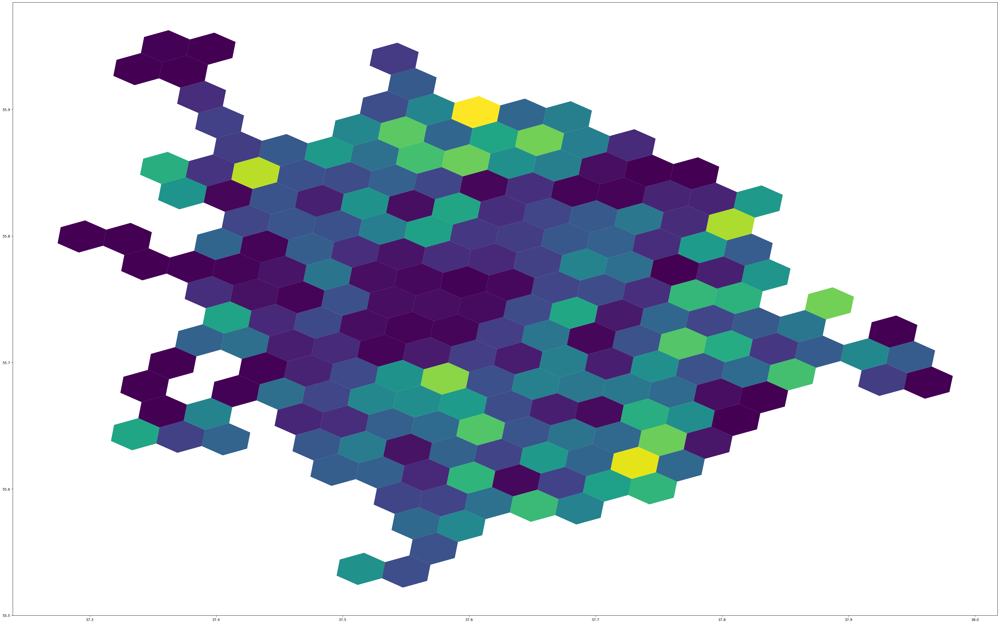

In [899]:
# geo_predict_df_Hexagon.plot(figsize=(50,50), column='hist_gradient_predict')
geo_predict_df_Hexagon_7.plot(figsize=(50,50), column='hist_gradient_predict')

<AxesSubplot:>

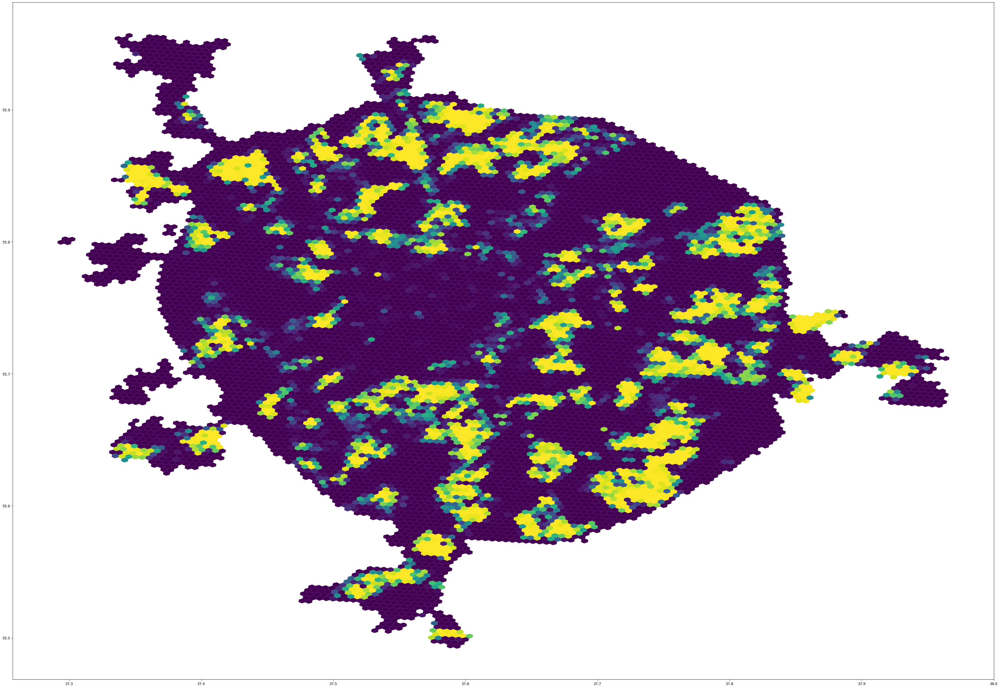

In [824]:
geo_predict_df_Hexagon.plot(figsize=(50,50), column='calibrated_forest_predict')

<AxesSubplot:>

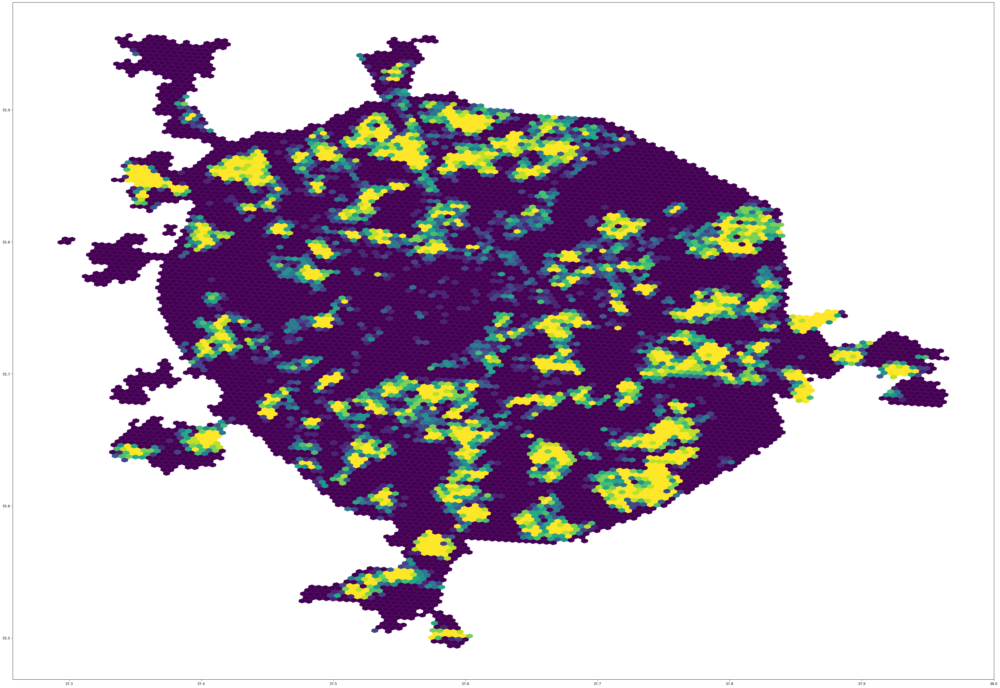

In [759]:
geo_predict_df_Hexagon.plot(figsize=(50,50), column='extra_predict')

<AxesSubplot:>

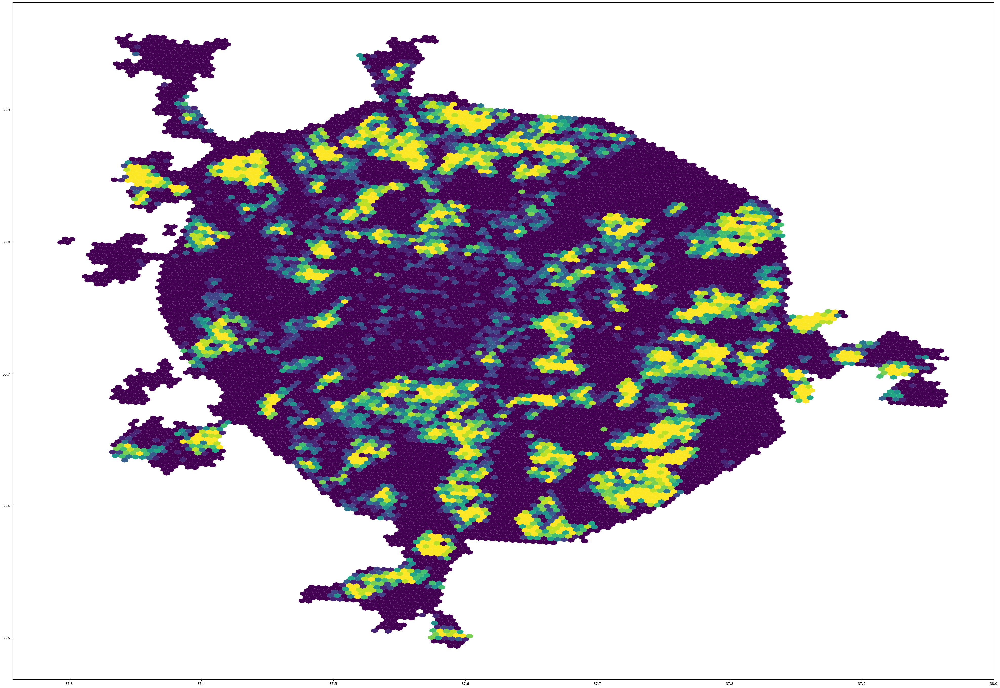

In [758]:
geo_predict_df_Hexagon.plot(figsize=(50,50), column='forest_predict')

<AxesSubplot:>

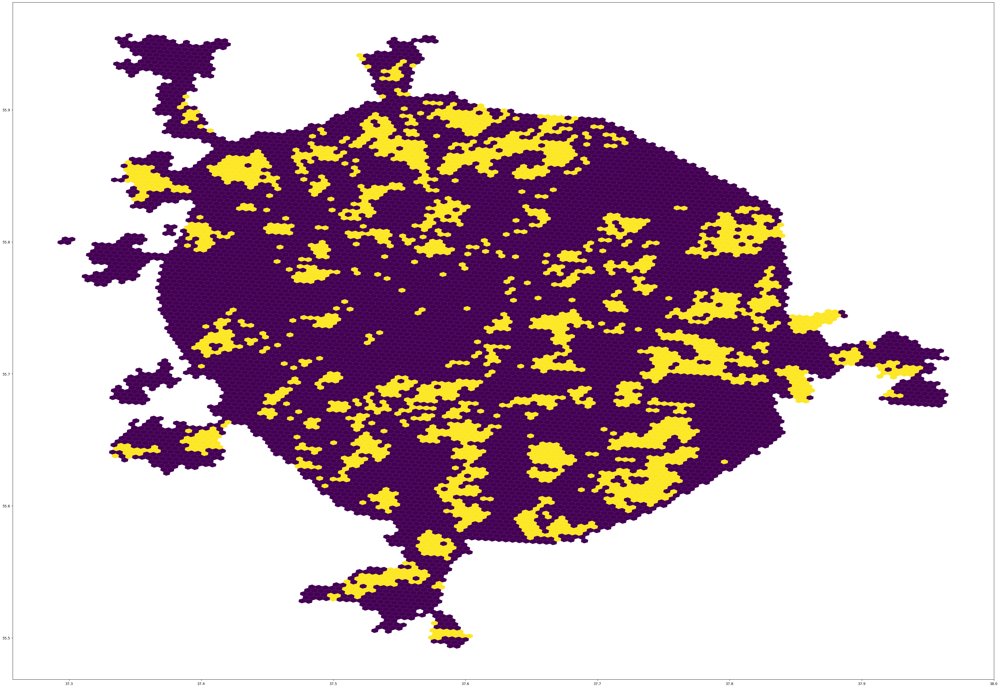

In [757]:
geo_predict_df_Hexagon.plot(figsize=(50,50), column='decis_predict')

<AxesSubplot:>

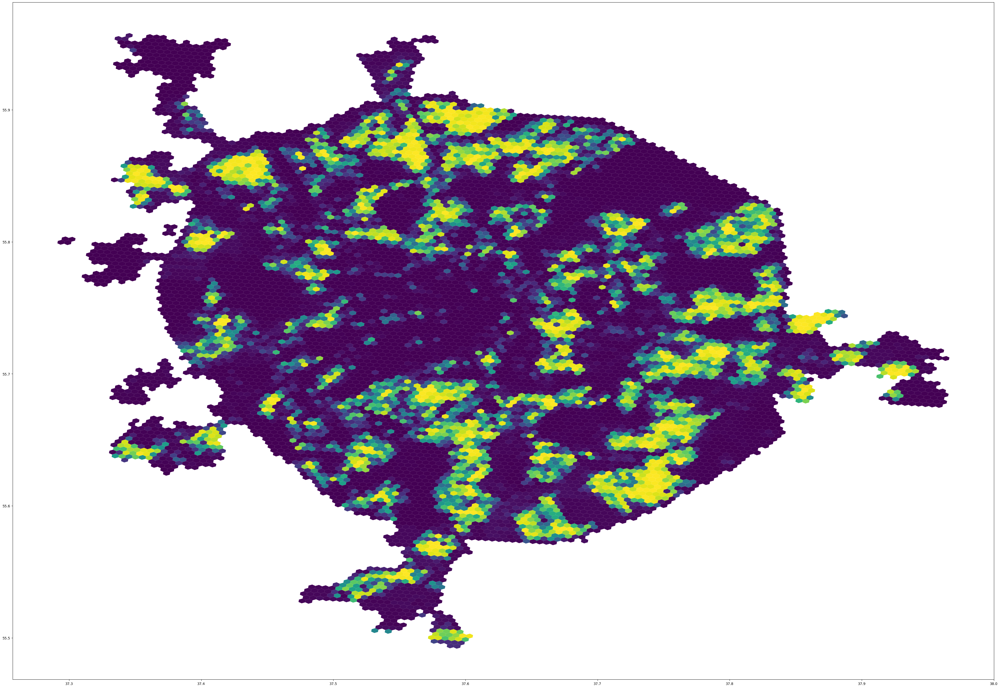

In [756]:
geo_predict_df_Hexagon.plot(figsize=(50,50), column='gradient_predict')

<AxesSubplot:>

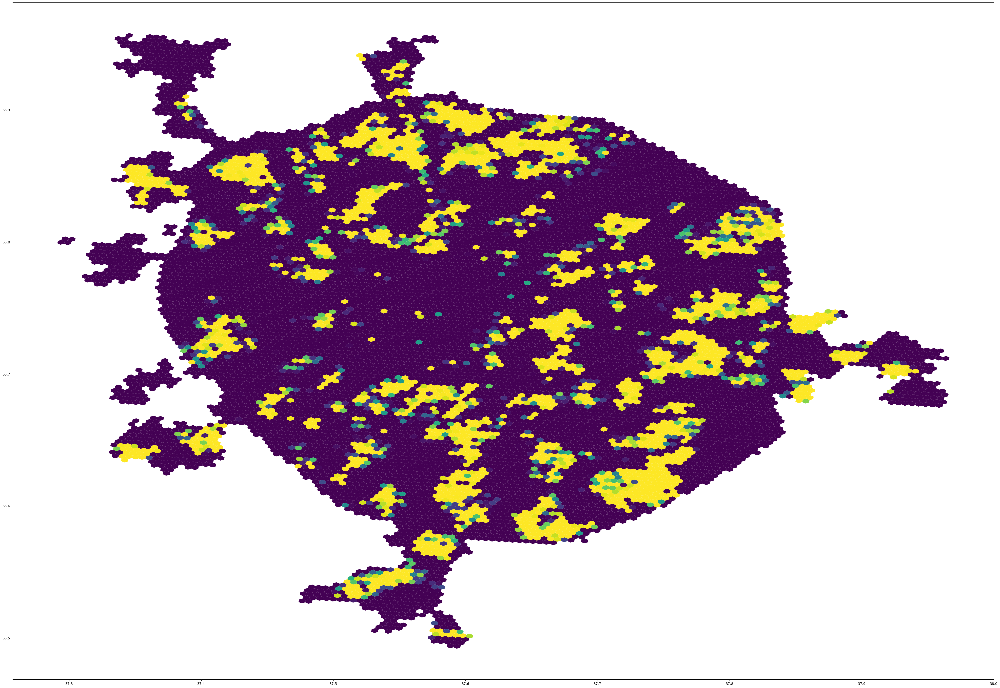

In [755]:
geo_predict_df_Hexagon.plot(figsize=(50,50), column='tf_predict')

<AxesSubplot:>

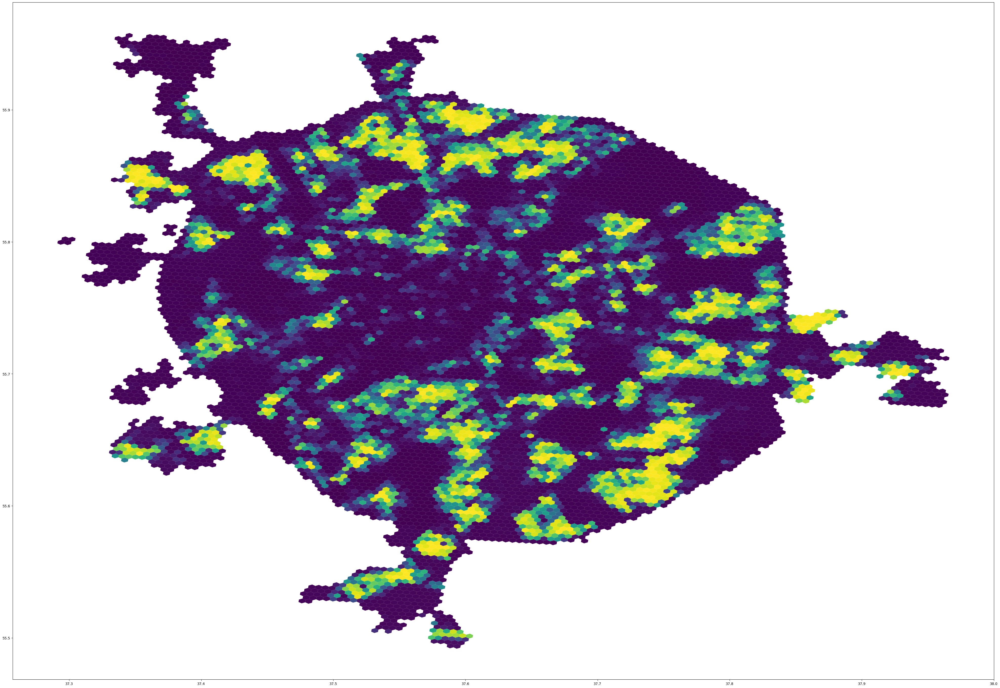

In [754]:
geo_predict_df_Hexagon.plot(figsize=(50,50), column='ensemble_predict')

In [798]:
# ensemble_predict
# geo_predict_df_Hexagon = ["ensemble_predict2"] = 
# geo_predict_df_Hexagon2 = geo_predict_df_Hexagon["ensemble_predict2"]
# test2 = geo_predict_df_Hexagon[geo_predict_df_Hexagon["ensemble_predict"] >= 0.008]
test2 = geo_predict_df_Hexagon.copy()


<AxesSubplot:>

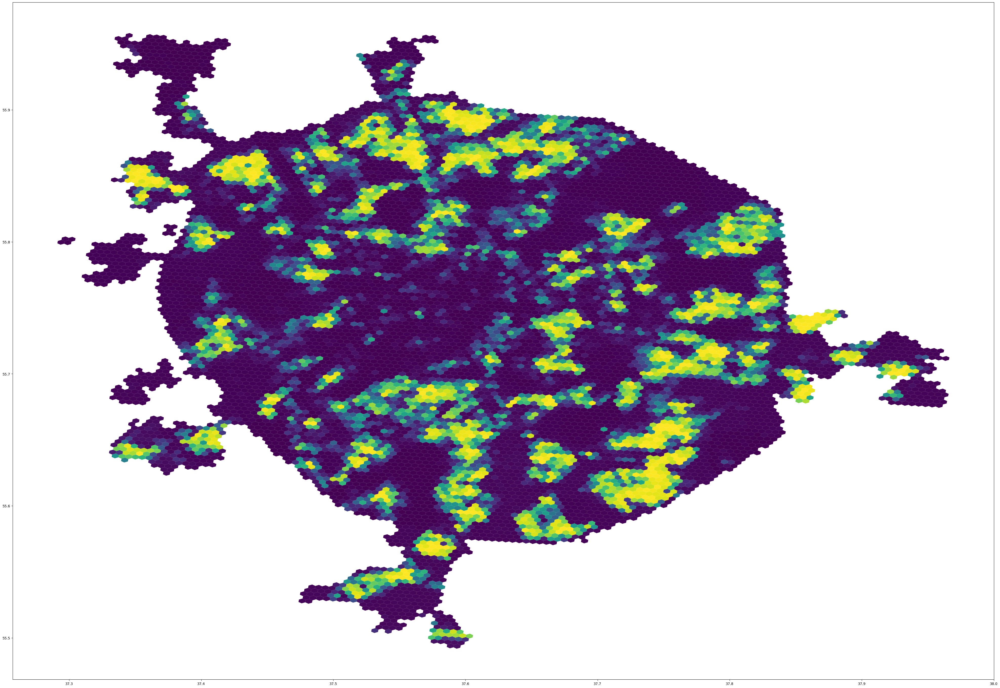

In [799]:
test2.plot(figsize=(50,50), column='ensemble_predict')

D:\_Work\_Projects\_Conda\School\lib\site-packages\geopandas\geodataframe.py:1351: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


<AxesSubplot:>

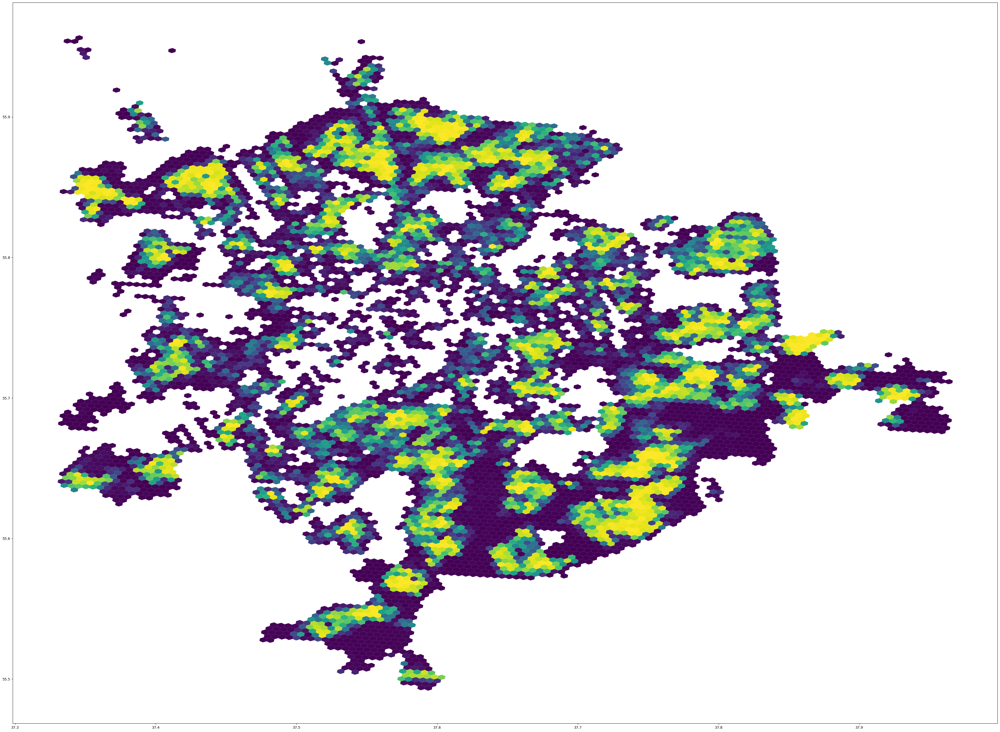

In [797]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler
scaler = MinMaxScaler((0,0.2))
# scaler = StandardScaler(with_mean =False)
# min_max_scaler.fit_transform()
test2["test2"] =  scaler.fit_transform(test2['ensemble_predict'].values.reshape(-1, 1))
test2.plot(figsize=(50,50), column='test2')
# test2.describe()

In [580]:
# df_temp = df_Hexagon.copy()
# # Сохраняем данные о предсказаниях
# geodf_temp = geopandas.GeoDataFrame(
#     df_temp, geometry=geopandas.points_from_xy(df_temp.lon, df_temp.lat))
# geodf_temp["geometry"] = []
# geodf_temp.to_file(PATH_DATASET + "temp_predict_hexagon_10_without_geometry.json", driver="GeoJSON") 


In [ ]:
geo_predict_df_Hexagon.to_file(PATH_DATASET + "predict_hexagon_10_without_geometry.json", driver="GeoJSON") 

In [407]:
# # Сохраняем данные о предсказаниях
# test_df.to_csv(PATH_DATASET + "predict_postamats.csv", sep=";", index=False)


# # test2 = geopandas.read_file(PATH_DATASET + "predict_postamats.csv", encoding='utf-8')
# predict_df = pd.read_csv(PATH_DATASET + "predict_postamats.csv", encoding='utf-8', sep=";")
# # geopandas.GeoDataFrame(
# geo_predict_df = geopandas.GeoDataFrame(
#     predict_df, geometry=geopandas.points_from_xy(predict_df.lon, predict_df.lat))
# # test_df = geopandas.GeoDataFrame()
# geo_predict_df.to_file(PATH_DATASET + "predict_postamats.json", driver="GeoJSON") 


In [ ]:
test_df[test_df["ensemble_predict"] > 0.5]["count_nearest_postamats"].mean()

In [ ]:
test_df[test_df["ensemble_predict"] <= 0.5]["count_nearest_postamats"].mean()